# Etape 3 : Etudiez la faisabilité de classification en utilisant des techniques de traitement d'image basiques

## **Important :**
Nous avons la confirmation de Linda (Lead Data Scientist chez "place de marché") qu'elle a vérifié qu'il n'y avait aucune contrainte de propriété intellectuelle sur les données et les images utilisées dans ce projet.

## Import des librairies :

In [1]:
# builtin

from os import listdir
import os
import time

# data 

import numpy as np
import pandas as pd

# viz

from IPython.display import display
from matplotlib.image import imread
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
import seaborn as sns

# images processing
from PIL import Image, ImageEnhance, ImageOps, ImageFilter
import cv2

# ML

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.metrics import silhouette_score
from sklearn.cluster import MiniBatchKMeans
from sklearn.manifold import TSNE
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics.cluster import adjusted_rand_score
import tensorflow as tf
from sklearn.metrics import confusion_matrix


# optimization

from joblib import Parallel, delayed, dump, load

2024-10-09 12:33:25.781983: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-09 12:33:25.850872: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-09 12:33:25.869971: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-09 12:33:25.979449: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-10-09 12:33:27.346729: W tensorflow/compiler/tf2

In [2]:
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

Image.MAX_IMAGE_PIXELS = 1000000000

In [3]:
print("Is GPU available:", tf.config.list_physical_devices('GPU'))

Is GPU available: []


##### Fonctions génériques :

In [4]:
def format_func(value, tick_number):
        return f'{value:,.1f}'.replace(',', ' ')


def ARI_and_TSNE(X, y_true):
    """"""
    begin = time.time()
    # TSNE reduction
    X_tsne = TSNE(n_components=2, 
                        learning_rate='auto', 
                        init='random', 
                        perplexity=30,
                        random_state=42
                       ).fit_transform(X)

    df_tsne = pd.DataFrame(data=X_tsne, columns=["TSNE_1", "TSNE_2"])
    
    kmeans = KMeans(n_clusters=7, 
                    init="k-means++", 
                    n_init=10,
                    random_state=42)
    kmeans.fit(X_tsne)

    labels_pred = kmeans.labels_
    ari = adjusted_rand_score(y_true, labels_pred)
    end = time.time()
    df_tsne['cluster'] = labels_pred
    print(f"It takes {end - begin} s.")
    return ari, df_tsne

def visualize_tsne(df_tsne, y_true):
    ari = adjusted_rand_score(y_true, df_tsne['cluster'])
    plt.figure(figsize=(10, 7))
    sns.scatterplot(
        x="TSNE_1", 
        y="TSNE_2", 
        hue="cluster", 
        data=df_tsne, 
        palette=clusters_palette
    )
    plt.title(f"Visualization of t-SNE Clusters (ARI: {ari:.4f})")
    plt.show()
    print(f"ARI score : {ari}")

#####  

In [5]:
# init sns

#sns.set()

In [6]:
%matplotlib inline
# palette clusters colors
clusters_palette = {
    -1: "#808080",
    0: "#66c2a5",
    1: "#fc8d62",
    2: "#8da0cb",
    3: "#e78ac3",
    4: "#a6d854",
    5: "#ffd92f",
    6: "#e5c494",
    7: "#b3b3b3",
}

In [51]:
# import dataframe with images names with categories

dataset = pd.read_csv('data/cleaned/dataset_with_categories.csv')

In [52]:
# make a new dataframe with only images names and categories

columns = ['image', 'category']
df = dataset[columns]
df.shape

(1050, 2)

---
---
## 3.1 -  Exploration :

Explorer le dossier d'images fournies :

In [7]:
# folder path

folder = "./data/Flipkart/Images/"

In [11]:
# make a list of every images in the folder

list_images = df.image.to_list()
print(f"There are {len(list_images)} images in the folder.")

There are 1050 images in the folder.


In [12]:
# image name example

list_images[521]

'66b75f053cb7626f49f1a9bffe77b451.jpg'

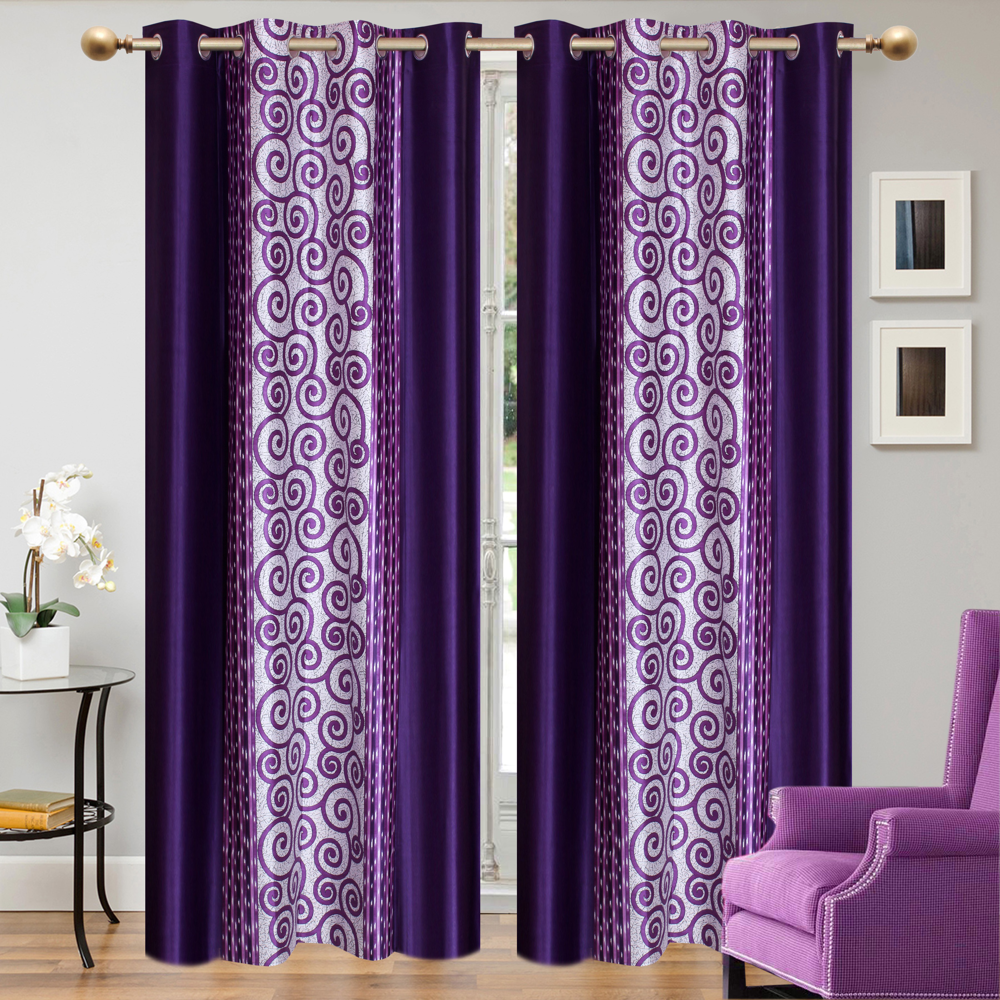

In [13]:
# display first image

filename = folder + list_images[0]

img = Image.open(filename)
display(img)

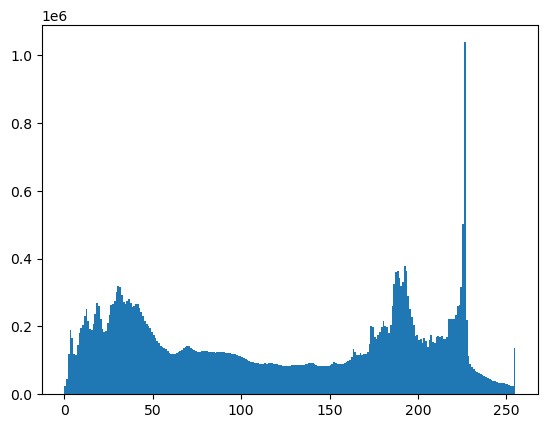

In [14]:
# image to numpy array

img_array = np.array(img)

# display histogram

n, bins, patches = plt.hist(img_array.flatten(), bins=range(256))
plt.show()

**Commentaires :**  
Le premier article en image est une paire de rideaux.  

---
---
## 3.2 - Preprocessing d'images avec Pillow :

**Statégie de prétraitements des images :**  
* Affichage d'exemples d'images
* Passage de couleur en nuances de gris
* Visualisation des histogramme de niveaux de gris
* Egalisation des histogrammes
* Réduction du bruit par un léger "flou gaussien"
* Normalisation

#### Affichage de 6 images :

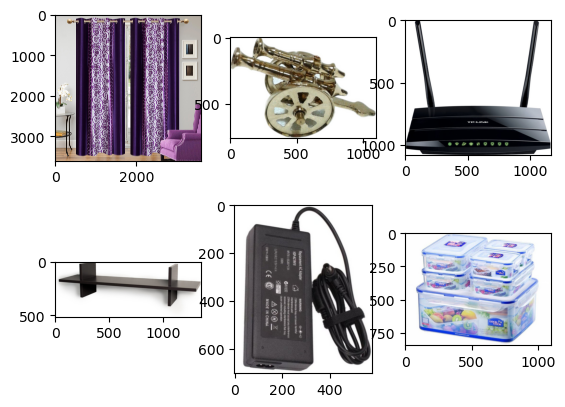

In [15]:
idx_list = [p for p in range(0, 1200, 200)]

for idx, value in enumerate(idx_list):
    plt.subplot(230 + 1 + idx)
    filename = folder + list_images[value]
    img = imread(filename)
    plt.imshow(img)
plt.show()

#### Passage en nuance de gris :

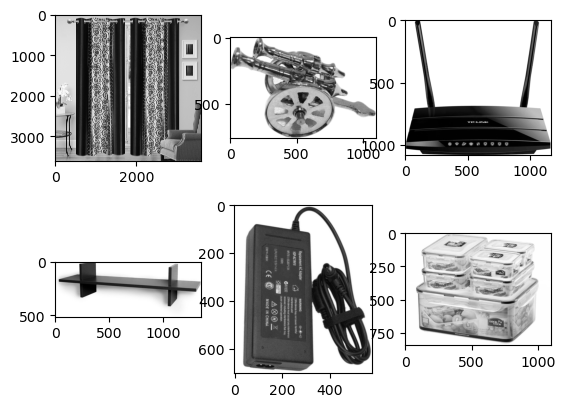

In [17]:
for idx, value in enumerate(idx_list):
    plt.subplot(230 + 1 + idx)
    filename = folder + list_images[value]
    img = Image.open(filename)
    img = img.convert('L')
    plt.imshow(img, cmap='gray')
plt.show()

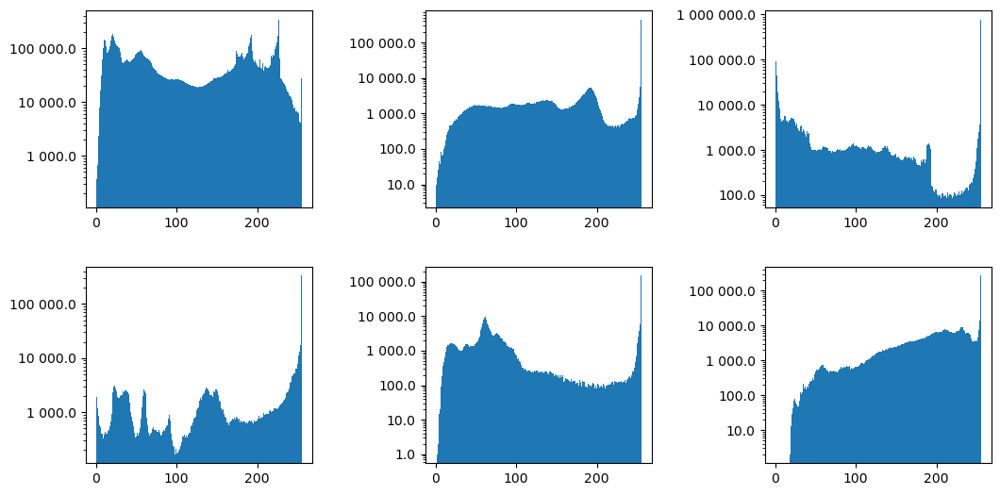

In [18]:
plt.figure(figsize=(12, 6))
for idx, value in enumerate(idx_list):
    ax = plt.subplot(230 + 1 + idx)
    filename = folder + list_images[value]
    img = Image.open(filename)
    img = img.convert('L')
    n, bins, patches = plt.hist(np.array(img).flatten(), bins=range(256), log=True)
    ax = plt.gca()
    ax.yaxis.set_major_formatter(FuncFormatter(format_func))
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.5, hspace=0.3)
plt.show()

#### Egalisation des histogrammes :

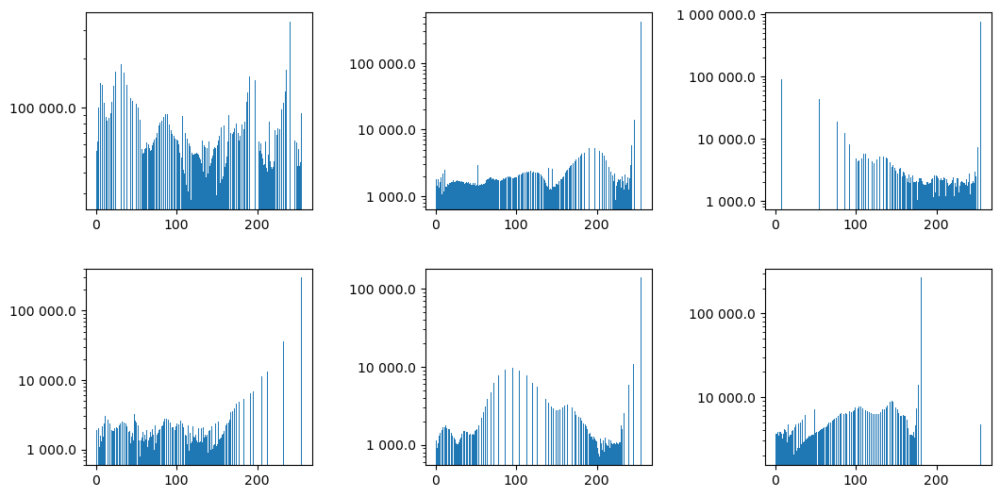

In [19]:
plt.figure(figsize=(12, 6))
for idx, value in enumerate(idx_list):
    ax = plt.subplot(230 + 1 + idx)
    filename = folder + list_images[value]
    img = Image.open(filename)
    img = img.convert('L')
    img = ImageOps.equalize(img)
    n, bins, patches = plt.hist(np.array(img).flatten(), bins=range(256), log=True)
    ax = plt.gca()
    ax.yaxis.set_major_formatter(FuncFormatter(format_func))
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.5, hspace=0.3)
plt.show()

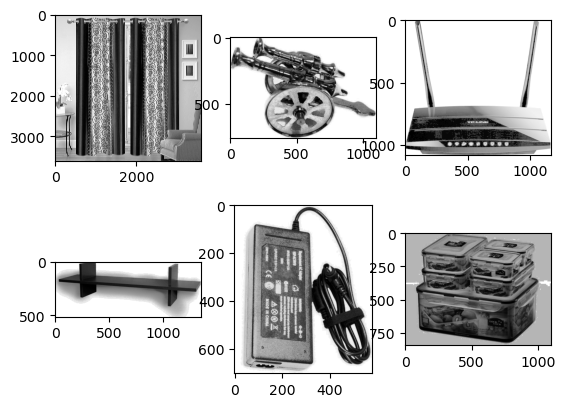

In [20]:
# display images with equalization

for idx, value in enumerate(idx_list):
    plt.subplot(230 + 1 + idx)
    filename = folder + list_images[value]
    img = Image.open(filename)
    img = img.convert('L')
    img = ImageOps.equalize(img)
    plt.imshow(img, cmap='gray')
plt.show()

#### Réduction du bruit par un "flou gaussien" :

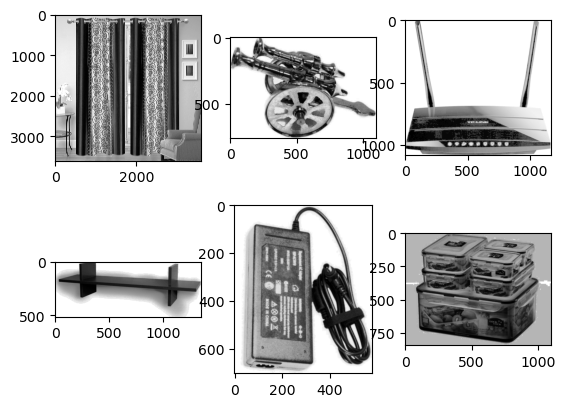

In [21]:
for idx, value in enumerate(idx_list):
    plt.subplot(230 + 1 + idx)
    filename = folder + list_images[value]
    img = Image.open(filename)
    img = img.convert('L')
    img = ImageOps.equalize(img)
    img = img.filter(ImageFilter.GaussianBlur(radius=1))
    plt.imshow(img, cmap='gray')
plt.show()

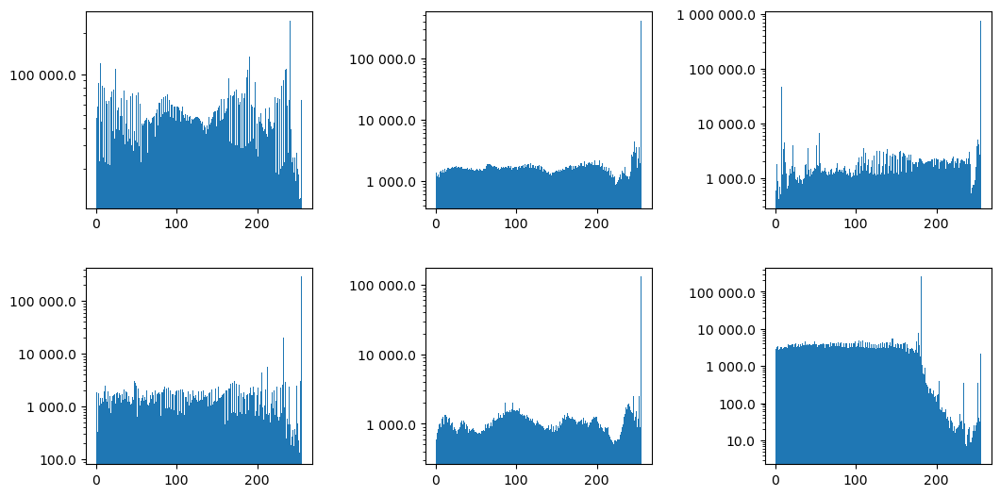

In [22]:
plt.figure(figsize=(12, 6))
for idx, value in enumerate(idx_list):
    ax = plt.subplot(230 + 1 + idx)
    filename = folder + list_images[value]
    img = Image.open(filename)
    img = img.convert('L')
    img = ImageOps.equalize(img)
    img = img.filter(ImageFilter.GaussianBlur(radius=1))
    n, bins, patches = plt.hist(np.array(img).flatten(), bins=range(256), log=True)
    ax = plt.gca()
    ax.yaxis.set_major_formatter(FuncFormatter(format_func))
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.5, hspace=0.3)
plt.show()

#### Normalisation :

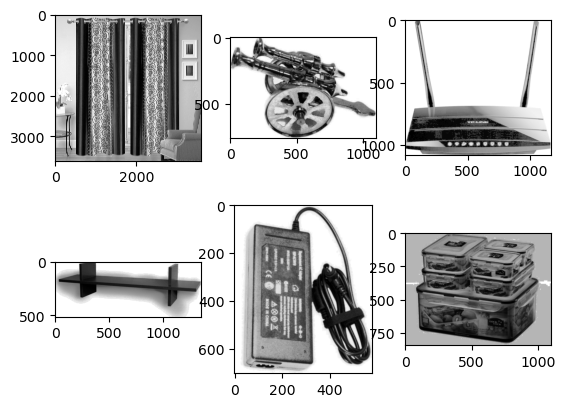

In [23]:
for idx, value in enumerate(idx_list):
    plt.subplot(230 + 1 + idx)
    filename = folder + list_images[value]
    img = Image.open(filename)
    img = img.convert('L')
    img = ImageOps.equalize(img)
    img = img.filter(ImageFilter.GaussianBlur(radius=1))
    img = ImageOps.autocontrast(img)
    plt.imshow(img, cmap='gray')
plt.show()

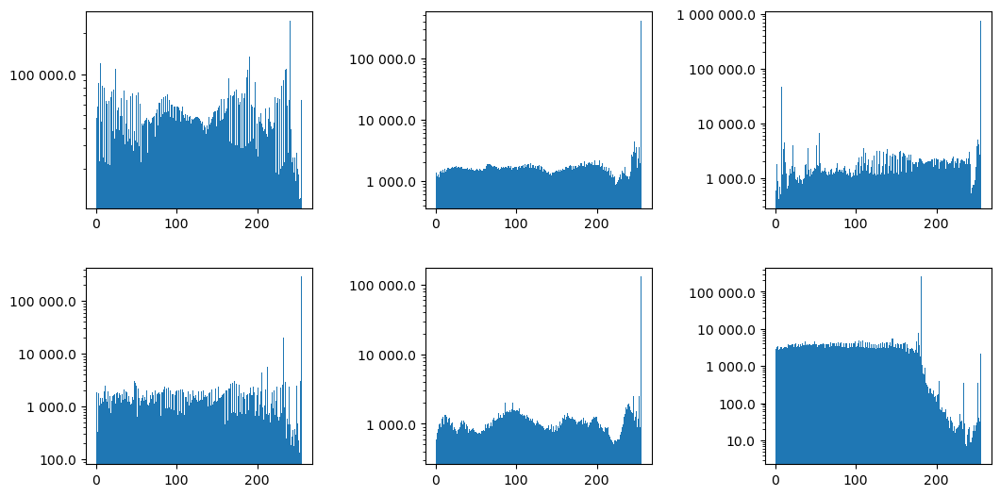

In [24]:
plt.figure(figsize=(12, 6))
for idx, value in enumerate(idx_list):
    ax =plt.subplot(230 + 1 + idx)
    filename = folder + list_images[value]
    img = Image.open(filename)
    img = img.convert('L')
    img = ImageOps.equalize(img)
    img = img.filter(ImageFilter.GaussianBlur(radius=1))
    img = ImageOps.autocontrast(img)
    n, bins, patches = plt.hist(np.array(img).flatten(), bins=range(256), log=True)
    ax = plt.gca()
    ax.yaxis.set_major_formatter(FuncFormatter(format_func))
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.5, hspace=0.3)
plt.show()

##### Fonctions :

In [25]:
def image_preprocessing(img):
    """
    function to preprocess a picture :
    1. convert to grayscale
    2. equalize histogram
    3. reduce noise with gaussian blur
    4. normalization

    return preprocessed picture 
    """
    img = Image.open(img)
    img = img.convert('L')
    img = ImageOps.equalize(img)
    img = img.filter(ImageFilter.GaussianBlur(radius=1))
    img = ImageOps.autocontrast(img)

    return img  

#####  

---
---
## 3.3 - Extraction de features :

### 3.3.1 - Test sur 1 image avec pré-traitement sous OpenCV (pré-traitement en masse):  
* Passage de couleur en nuances de gris
* Egalisation des histogrammes
* Réduction du bruit par un léger "flou gaussien"
* Normalisation

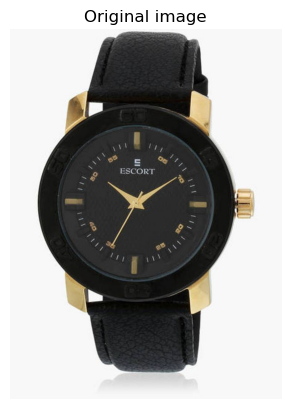

In [35]:
# display a sample picture

filename = folder + list_images[15]

image = cv2.imread(filename)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original image')
plt.axis('off')
plt.show()

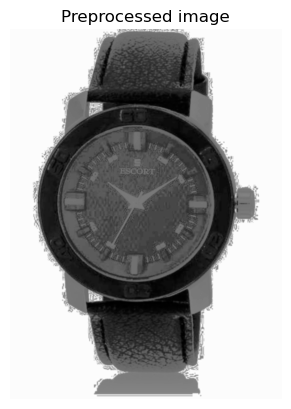

In [36]:
# convert to grayscale

gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# equalized histogram

equalized_image = cv2.equalizeHist(gray_image)

# reduce noise

blurred_image = cv2.GaussianBlur(equalized_image, (5, 5), 0)

# normalized

normalized_image = cv2.normalize(blurred_image, None, 0, 255, cv2.NORM_MINMAX)

# display
plt.imshow(normalized_image, cmap='gray')
plt.title('Preprocessed image')
plt.axis('off')
plt.show()

##### Recherche des points d'intérêts

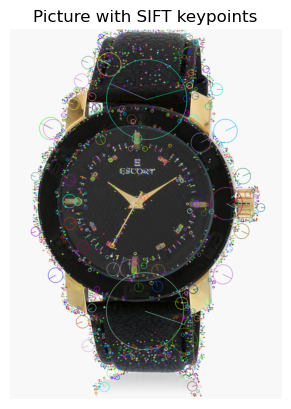

Number of keypoints : 2745


In [37]:
# SIFT creation
sift = cv2.SIFT_create()

# detect keypoints and calculate descriptors
keypoints, descriptors = sift.detectAndCompute(normalized_image, None)

# draw keypoints
image_with_keypoints = cv2.drawKeypoints(image, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# display SIFT keypoints on the picture
plt.imshow(cv2.cvtColor(image_with_keypoints, cv2.COLOR_BGR2RGB))
plt.title('Picture with SIFT keypoints')
plt.axis('off')
plt.show()

print(f"Number of keypoints : {len(keypoints)}")

In [38]:
descriptors.shape

(2745, 128)

---
### 3.3.2 - Extraction des descripteurs de toutes les images :

Création d'une fonction 

In [29]:
def extract_descriptors_by_picture(img_path):

    sift = cv2.SIFT_create(500)
    
    img = cv2.imread(img_path)
    gray_image = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    equalized_image = cv2.equalizeHist(gray_image)
    blurred_image = cv2.GaussianBlur(equalized_image, (5, 5), 0)
    normalized_image = cv2.normalize(blurred_image, None, 0, 255, cv2.NORM_MINMAX)
    
    # extraction
    keypoints, descriptors = sift.detectAndCompute(normalized_image, None)
    
    # if no descriptors => return empty array
    if descriptors is not None:
        return descriptors
    else:
        return np.array([])  

In [30]:
# list of image paths

image_paths = [os.path.join(folder, image) for image in list_images]

In [53]:
begin = time.time()

# extract descriptors with joblib with all cores
descriptors_list = Parallel(n_jobs=-1)(
    delayed(extract_descriptors_by_picture)(
        img_path) for img_path in image_paths)

# delete empty array
descriptors_list = [desc for desc in descriptors_list if desc.size > 0]

# stack all descriptors 
all_descriptors = np.vstack(descriptors_list)

end = time.time()
print(f"Features extraction takes {end - begin} s.")
print(f"All_descriptors shape is : {all_descriptors.shape}")

Features extraction takes 101.77694606781006 s.
All_descriptors shape is : (514634, 128)


---
#### Extraction de features exécutée sur PC Gamer, puis récupération sur le serveur par `pickle`

In [13]:
import pickle

In [56]:
# save descriptors_list to a pickle file
with open('all_descriptors.pkl', 'wb') as f: # 'wb' = "write binary"
    pickle.dump(all_descriptors, f)

print("Array is saved !")

Array is saved !


In [40]:
# retrieve descriptors_list
with open('all_descriptors.pkl', 'rb') as f: # 'rb' = "read binary"
    all_descriptors = pickle.load(f)

print("Array is loaded : ", all_descriptors.shape)

Array is loaded :  (514634, 128)


---

---
---
## 3.4 - Création des `Bags of visual words` :

**Stratégie :**  

* Création des `visual words`
    1. Choix du nombre de clusters de descripteurs
    2. Clustering par KMeans
* Construction des histogrammes par images

---
### 3.4.1 - Choix du nombre de clusters de descripteurs :

Pour le choix du nombre de clusters de descripteurs, je vais 2 essais par :  

**Méthode 1 :**  
* La méthode empirique de la racine carré du nombre de descripteurs :
$$\sqrt{514634} \approx 717$$

**Méthode 2 :**  
* La méthode empirique de prendre 10 fois le nombre de catégories :
$$10 * 7 = 70$$  


---
### 3.4.2 - KMeans - k = 717 :

In [41]:
# retrieve descriptors array

X = pd.DataFrame(all_descriptors)

In [42]:
# fit  and time

kmeans_square = MiniBatchKMeans(n_clusters=717, init="k-means++", n_init=1, random_state=42)

start_time = time.time()
kmeans_square.fit(X)
end_time = time.time()
print("Clustering took {:.2f} s".format(end_time - start_time))

Clustering took 2.22 s


In [66]:
# save model

dump(kmeans_square, './data/models/kmeans_square.joblib')

['./data/models/kmeans_square.joblib']

In [67]:
# retrieve model

kmeans_square = load('./data/models/kmeans_square.joblib')

---
### 3.4.3 - Création des histogrammes :

* Pour chaque image : 
   - prédiction des numéros de cluster de chaque descripteur
   - création d'un histogramme = comptage du nombre de descripteurs dans chaque cluster (visual word)

[Numpy Hist explanation](https://stackoverflow.com/questions/9141732/how-does-numpy-histogram-work)

In [31]:
# encoding original categories to calculate ARI

encoder = LabelEncoder()
true_labels_encoded = encoder.fit_transform(df['category'])
df.loc[:,'category_encoded'] = true_labels_encoded

/tmp/ipykernel_17326/1348133774.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:,'category_encoded'] = true_labels_encoded


In [46]:
#df.head()

In [47]:
histograms = []

def histogram_by_image(img_desc, model, k):
    """
    make histogram by image from image descriptors
    * retrieve model prediction's labels and create histogram
    -img_desc : image descriptors to process
    -model : name of trained model 
    -k : number of clusters used
    
    """
    
    labels = model.predict(img_desc)
    hist, bin_edges = np.histogram([labels], bins=np.arange(k+1))
    return hist

def all_histograms(i, model, k):
    """
    from an image location in df, extract descriptors and create histogram
    -i : image row in df
    -model : name of model for function: histogram_by_image
    -k : number of clusters used for function: histogram_by_image
    """
    
    image_path = folder + df.loc[i].at['image']
    desc = extract_descriptors_by_picture(image_path)
    hist = histogram_by_image(desc, model, k)
    return hist

In [75]:
# create histograms for all images in the folder with joblib

begin = time.time()
hist_results = Parallel(n_jobs=8)(delayed(all_histograms)(i, kmeans_square, 717) for i in range(len(df)))
end = time.time()

print(f"It takes {end - begin} s.")

It takes 105.02838969230652 s.


In [76]:
# transform in array

hists = np.array(hist_results)

In [77]:
hists.shape

(1050, 717)

In [78]:
# save hists to a pickle file
with open('./data/histograms/hists_717.pkl', 'wb') as f: # 'wb' = "write binary"
    pickle.dump(hists, f)

print("Array is saved !")

Array is saved !


In [48]:
# retrieve hists
with open('./data/histograms/hists_717.pkl', 'rb') as f: # 'rb' = "read binary"
    hists = pickle.load(f)

print("Array is loaded : ", hists.shape)

Array is loaded :  (1050, 717)


**Commentaires :**  
Nous avons désormais 1050 vecteurs de 717 dimensions.

---
---
## 3.5 - Réduction de dimension :

**Stratégie :**  
* Réduction par ACP :
    1. Recherche du nombre de CP optimal (99% de variance expliquée)
    2. Réalisation de l'ACP
    3. Enregistrement en dataframe

---
### 3.5.1 - Recherche du nombre de Composantes principales optimal :

In [84]:
# PCA fit_transform to dense matrix

pca = PCA()
principalComponents = pca.fit_transform(hists)

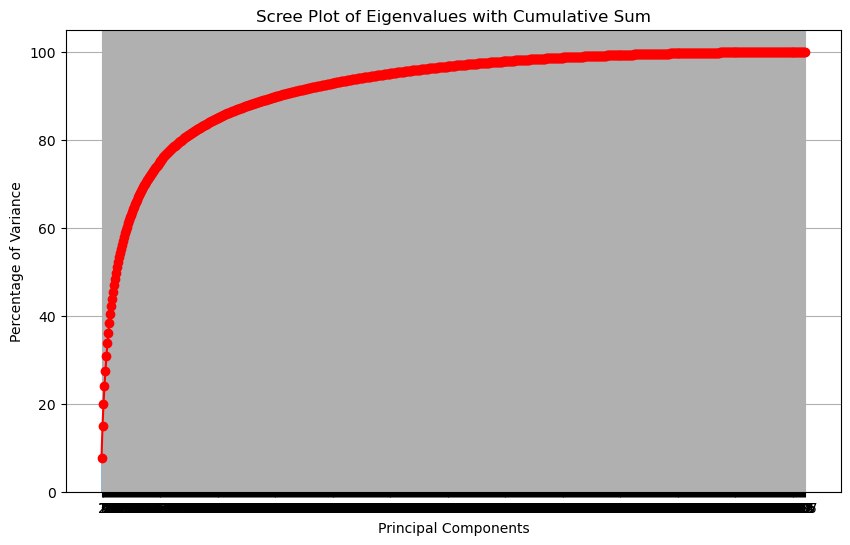

,Principal Components,Explained variance,% Explained Variance,% cum. Exp. Variance
455,PC456,0.419862,0.0,99.0
456,PC457,0.419088,0.0,99.0
457,PC458,0.415545,0.0,99.0
458,PC459,0.412820,0.0,99.0
459,PC460,0.411673,0.0,99.0


In [85]:
exp_var_df = pd.DataFrame({
        "Principal Components" : ["PC" + str(x + 1) for x in range(pca.n_components_)], 
        "Explained variance" : pca.explained_variance_,
        "% Explained Variance" : np.round(pca.explained_variance_ratio_ * 100),
        "% cum. Exp. Variance" : np.round(np.cumsum(pca.explained_variance_ratio_) * 100)})

# calculate explained variance and cumulative

explained_variance = pca.explained_variance_ratio_ * 100
cumulative_variance = explained_variance.cumsum()

# show scree plot

plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center')
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', color='r')
plt.title('Scree Plot of Eigenvalues with Cumulative Sum')
plt.xlabel('Principal Components')
plt.ylabel("Percentage of Variance")
plt.xticks(range(1, len(explained_variance) + 1))
plt.grid(True)
plt.show()
pertinent_df = exp_var_df[exp_var_df['% cum. Exp. Variance'] == 99]
display(pertinent_df.head())

**Commentaires :**  
Avec 456 Composantes Principales, on retrouve 99% de la variance.

---
### 3.5.2 - Application de l'ACP :

In [56]:
# execute PCA on the descriptors matrix

n_components = 456

pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(hists)

In [57]:
# create dataframe with columns name

pc_df = pd.DataFrame(principal_components, 
                     columns=["PC" + str(x + 1) for x in range(n_components)]
                    )

In [58]:
pc_df.shape

(1050, 456)

In [59]:
pc_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC447,PC448,PC449,PC450,PC451,PC452,PC453,PC454,PC455,PC456
0,-3.574987,-1.714397,16.487570,-0.738208,1.746753,-4.686372,2.563784,-7.798357,0.092134,2.292888,...,-0.295279,0.223944,0.091531,0.271477,0.692525,0.306813,0.366754,-0.216268,0.076869,0.128824
1,-3.324854,0.833821,13.123903,-4.349757,-3.218812,-0.823847,-1.495553,-1.348246,5.303212,-2.611481,...,0.119600,0.140033,-0.143016,-0.674661,0.182355,0.681224,-0.607148,-0.670981,-0.212341,0.698682
2,-2.801838,-3.155614,7.722901,-13.081952,-10.765193,-6.835502,15.181550,0.573643,-5.291923,-8.445183,...,-0.361171,-0.061706,-0.520371,0.003342,-0.131784,-0.337690,-0.740943,0.788784,0.076916,-0.647073
3,-3.698133,2.092307,14.605008,-1.844712,-1.488661,0.109736,-4.713532,-1.480662,8.907087,-1.298835,...,0.066598,-1.177368,-1.338075,0.269156,-0.723640,0.115154,-0.031652,-0.264369,0.208919,-0.648847
4,-1.702820,1.117344,19.563469,2.619728,4.233265,6.885157,-2.843140,0.559044,7.752220,0.810600,...,0.052762,0.328184,0.478976,0.151823,0.629209,-0.651330,0.141268,-0.357702,0.405134,-0.248873


---
### 3.5.3 - Réduction de dimension t-SNE :

In [60]:
X_tsne = TSNE(n_components=2, 
                        learning_rate='auto', 
                        init='random', 
                        perplexity=30,
                        random_state=42
                       ).fit_transform(pc_df)

df_tsne = pd.DataFrame(data=X_tsne, columns=["TSNE_1", "TSNE_2"])
df_tsne['category'] = df['category']

In [61]:
df_tsne.shape

(1050, 3)

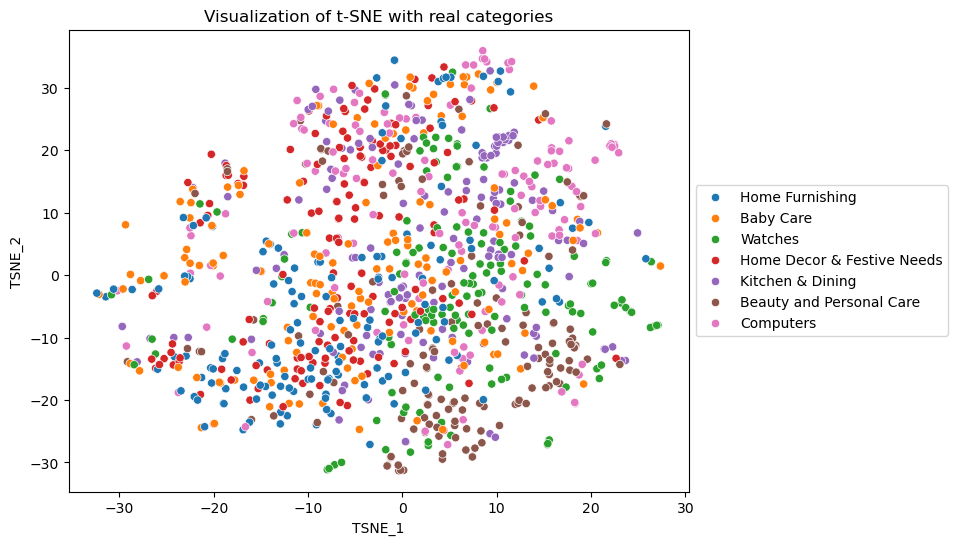

In [62]:
plt.figure(figsize=(8, 6))
sns.scatterplot(
        x="TSNE_1", 
        y="TSNE_2", 
        hue="category", 
        data=df_tsne, 
        palette=sns.color_palette('tab10', n_colors=7)
    )
plt.title(f"Visualization of t-SNE with real categories")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

**Commentaires :**  
Les catégories sont bien mélangées.

---
---
## 3.6 - Classification des images à partir des vecteurs :

**Stratégie :**  
1. Classification des vecteurs par KMeans en 7 catégories
2. Comparaison avec les catégories réelles (score ARI)

---
### 3.6.1 - Classification KMeans :

In [67]:
# fit kmeans and time

kmeans = KMeans(n_clusters=7, init="k-means++", n_init=1, random_state=42)

start_time = time.time()
kmeans.fit(X_tsne)
end_time = time.time()
print("Clustering took {:.2f} s".format(end_time - start_time))

Clustering took 0.01 s


In [68]:
# retrieve labels

df_tsne['cluster'] = kmeans.labels_

---
### 3.6.2 - Visualisation et score ARI :  

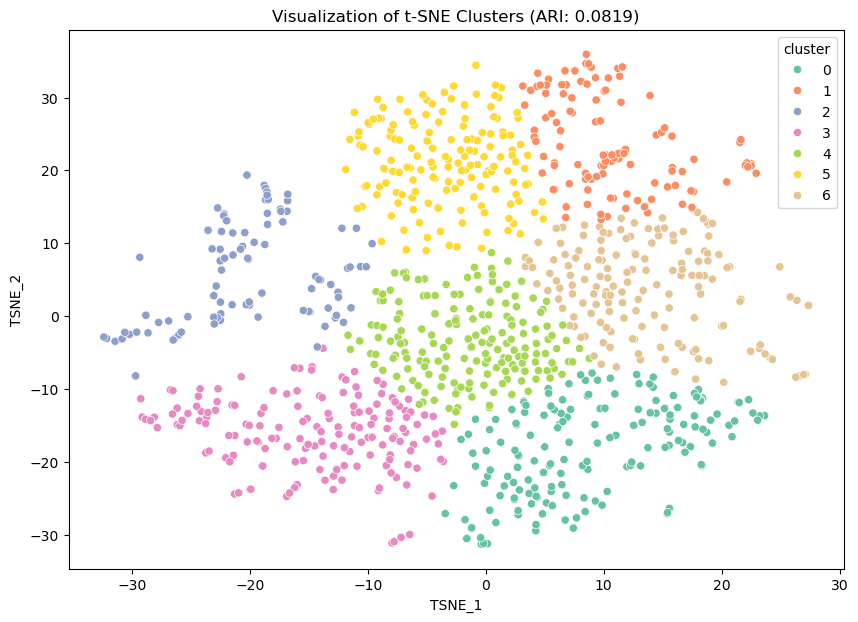

ARI score : 0.08194278161580153


In [69]:
# functions to reduce by t-SNE and calculate ARI score

visualize_tsne(df_tsne, true_labels_encoded)

**Commentaires :**  
* Graphiquement les clusters sont bien répartis
* Le score ARI est très bas : 0.0819

### 3.6.3 - Matrice de confusion :

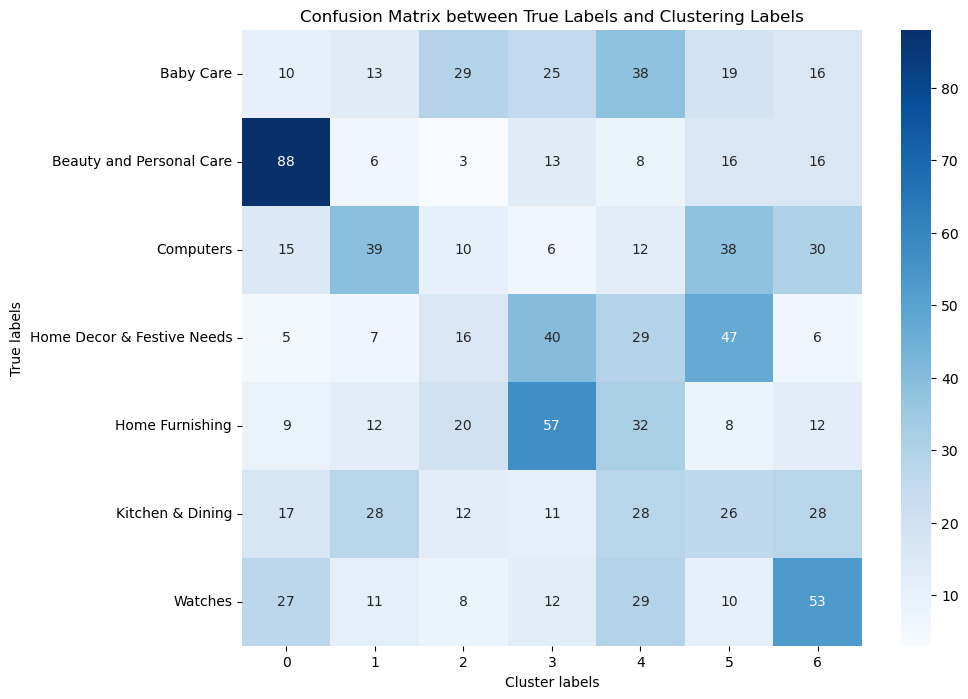

In [70]:
# confusion matrix
cm = confusion_matrix(df['category_encoded'], kmeans.labels_)

# heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=range(0, 7), yticklabels=encoder.classes_)
plt.xlabel('Cluster labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix between True Labels and Clustering Labels')
plt.show()

**Commentaires :**  
Il est difficile de déterminer les correspondances entre les clusters et les vraies catégories. Le mode n'aide pas plus que ça.

---
---
## 3.7 -  Création des `Bags of visual words` avec 70 clusters :

### 3.7.1 - KMeans des descripteurs à 70 clusters :

In [71]:
# fit pipeline and time

kmeans_ten = MiniBatchKMeans(n_clusters=70, init="k-means++", n_init=1, random_state=42)

start_time = time.time()
kmeans_ten.fit(X)
end_time = time.time()
print("Clustering took {:.2f} s".format(end_time - start_time))

Clustering took 0.47 s


In [72]:
dump(kmeans_ten, './data/models/kmeans_ten.joblib')

['./data/models/kmeans_ten.joblib']

In [12]:
kmeans_ten = load('./data/models/kmeans_ten.joblib')

---
### 3.7.2 - Création des histogrammes :
* Pour chaque image : 
   - prédiction des numéros de cluster de chaque descripteur
   - création d'un histogramme = comptage du nombre de descripteurs dans chaque cluster (visual word)

In [ ]:
begin = time.time()
hist_results = Parallel(n_jobs=-1)(delayed(all_histograms)(i, kmeans_ten, 70) for i in range(len(df)))
end = time.time()

print(f"It takes {end - begin} s.")

In [115]:
hists = np.array(hist_results)

In [116]:
hists.shape

(1050, 70)

In [117]:
# save hists to a pickle file
with open('./data/histograms/hists_70.pkl', 'wb') as f: # 'wb' = "write binary"
    pickle.dump(hists, f)

print("Array is saved !")

Array is saved !


In [14]:
# retrieve hists
with open('./data/histograms/hists_70.pkl', 'rb') as f: # 'rb' = "read binary"
    hists = pickle.load(f)

print("Array is loaded : ", hists.shape)

Array is loaded :  (1050, 70)


---
### 3.7.3 - Réduction de dimension - PCA :

In [15]:
# PCA fit_transform to dense matrix

pca = PCA()
principalComponents = pca.fit_transform(hists)

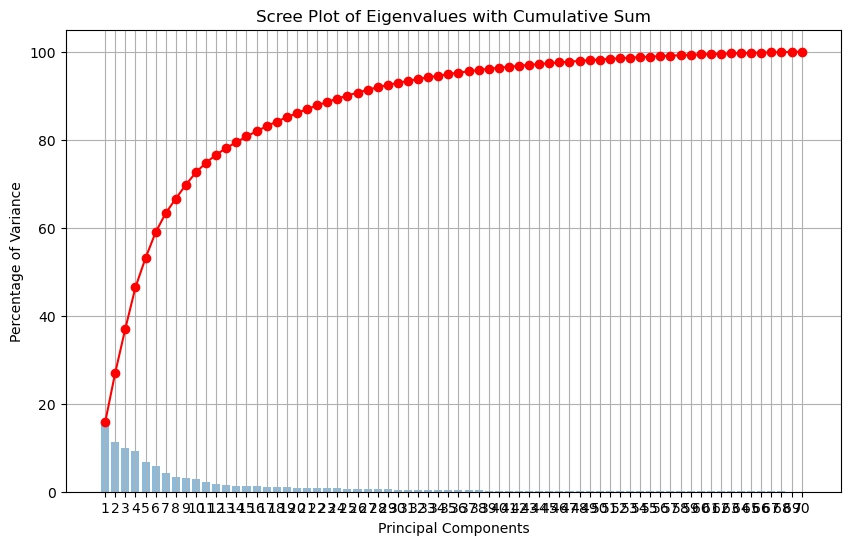

,Principal Components,Explained variance,% Explained Variance,% cum. Exp. Variance
51,PC52,12.217095,0.0,99.0
52,PC53,11.347120,0.0,99.0
53,PC54,11.022592,0.0,99.0
54,PC55,10.582218,0.0,99.0
55,PC56,9.631246,0.0,99.0


In [18]:
exp_var_df = pd.DataFrame({
        "Principal Components" : ["PC" + str(x + 1) for x in range(pca.n_components_)], 
        "Explained variance" : pca.explained_variance_,
        "% Explained Variance" : np.round(pca.explained_variance_ratio_ * 100),
        "% cum. Exp. Variance" : np.round(np.cumsum(pca.explained_variance_ratio_) * 100)})

# calculate explained variance and cumulative

explained_variance = pca.explained_variance_ratio_ * 100
cumulative_variance = explained_variance.cumsum()

# show scree plot

plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center')
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', color='r')
plt.title('Scree Plot of Eigenvalues with Cumulative Sum')
plt.xlabel('Principal Components')
plt.ylabel("Percentage of Variance")
plt.xticks(range(1, len(explained_variance) + 1))
plt.grid(True)
plt.show()
pertinent_df = exp_var_df[exp_var_df['% cum. Exp. Variance'] == 99]
display(pertinent_df.head())

**Commentaires :**  
Avec 52 Composantes Principales, on retrouve 99% de la variance.

In [19]:
# execute PCA on the descriptors matrix

n_components = 52

pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(hists)

In [20]:
# create dataframe with columns name

pc_df = pd.DataFrame(principal_components, 
                     columns=["PC" + str(x + 1) for x in range(n_components)]
                    )

In [21]:
pc_df.shape

(1050, 52)

In [22]:
pc_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,PC51,PC52
0,39.375820,-25.602394,1.283166,-35.532839,-13.769054,26.564460,28.698957,0.078083,-18.081000,4.661366,...,-7.103212,-10.800101,1.117408,12.307356,-1.243145,-0.149674,-4.931788,0.091945,4.121977,-5.098427
1,35.888385,-14.516587,-12.828307,-20.405723,-4.325392,-4.209808,7.021514,5.126060,-25.813505,14.885317,...,2.028201,0.486092,-1.416801,-0.067950,2.734481,-4.342486,5.169297,3.214286,0.324783,2.805316
2,17.815841,0.241685,-48.260546,-26.646453,38.066161,-17.092314,11.027204,10.284434,76.424136,3.990112,...,4.019885,0.808528,-0.481676,0.173266,-2.206974,0.312502,-0.162132,-3.535371,3.635826,-0.983460
3,57.388100,-31.966334,19.314391,-5.578085,0.252277,-15.014762,8.410348,0.409869,-27.975556,11.043899,...,-1.331366,5.393069,-0.039385,-4.980731,-0.459554,1.779049,-1.622911,9.356831,4.021660,-0.634952
4,61.543271,-29.477755,26.205504,-19.543108,-3.801778,-9.447472,0.273497,-6.910819,-28.548410,3.126330,...,1.651495,8.485451,-2.198690,-4.536359,3.377463,-4.670636,11.785219,-3.070334,-10.223420,11.560730


---
### 3.7.4 - Réduction de dimension t-SNE :

In [23]:
X_tsne = TSNE(n_components=2, 
                        learning_rate='auto', 
                        init='random', 
                        perplexity=30,
                        random_state=42
                       ).fit_transform(pc_df)

df_tsne = pd.DataFrame(data=X_tsne, columns=["TSNE_1", "TSNE_2"])
df_tsne['category'] = df['category']

In [24]:
df_tsne.shape

(1050, 3)

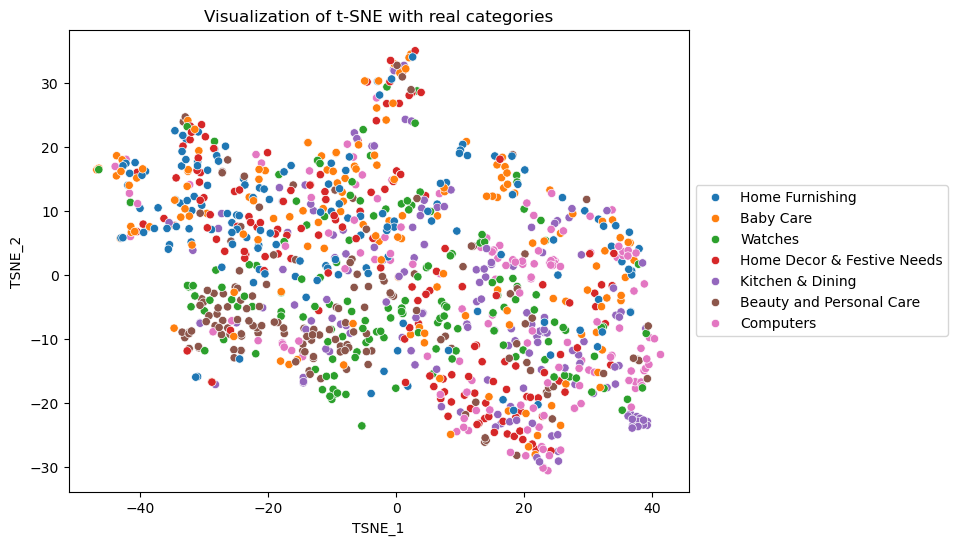

In [25]:
plt.figure(figsize=(8, 6))
sns.scatterplot(
        x="TSNE_1", 
        y="TSNE_2", 
        hue="category", 
        data=df_tsne, 
        palette=sns.color_palette('tab10', n_colors=7)
    )
plt.title(f"Visualization of t-SNE with real categories")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

**Commentaires :**  
Les catégories sont bien mélangées.

---
### 3.7.5 - Classification KMeans :

In [26]:
# fit kmeans and time

kmeans = KMeans(n_clusters=7, init="k-means++", n_init=1, random_state=42)

start_time = time.time()
kmeans.fit(X_tsne)
end_time = time.time()
print("Clustering took {:.2f} s".format(end_time - start_time))

Clustering took 0.01 s


In [27]:
# retrieve labels

df_tsne['cluster'] = kmeans.labels_

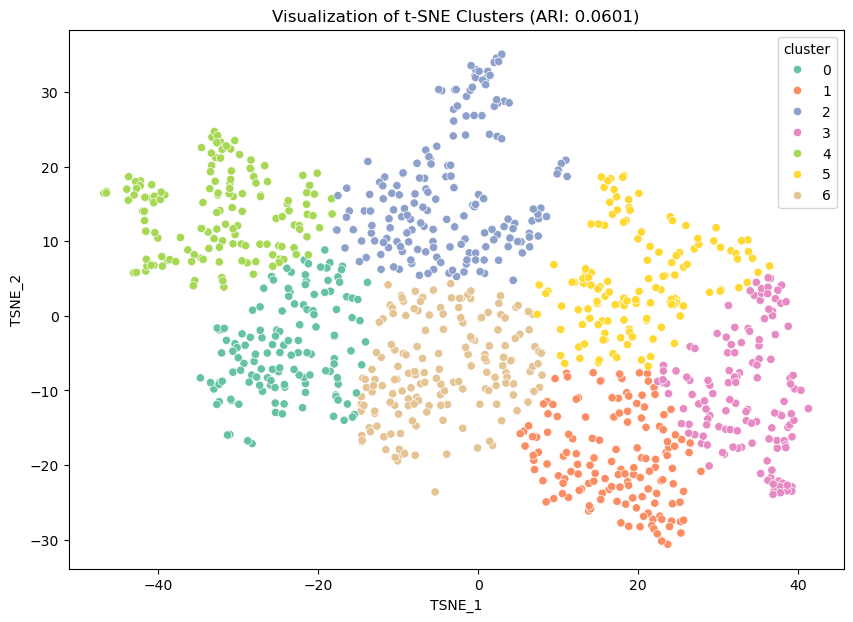

ARI score : 0.06011601858553863


In [32]:
# functions to reduce by t-SNE and calculate ARI score

visualize_tsne(df_tsne, true_labels_encoded)

**Commentaires :**  
* Graphiquement les clusters sont bien répartis
* Le score ARI est très bas : 0.0601

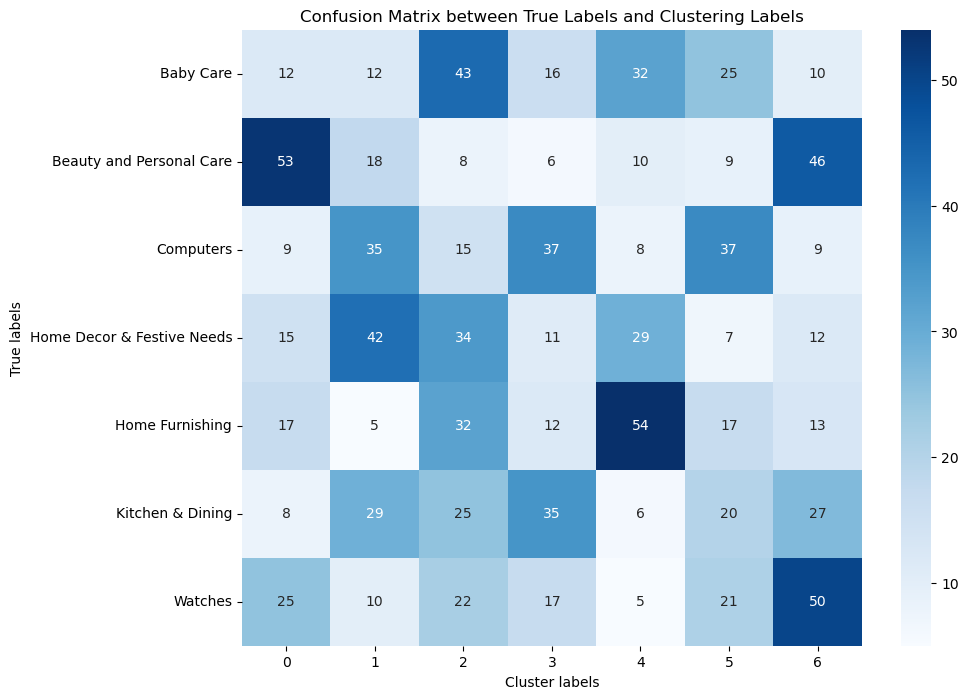

In [33]:
# confusion matrix
cm = confusion_matrix(df['category_encoded'], kmeans.labels_)

# heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=range(0, 7), yticklabels=encoder.classes_)
plt.xlabel('Cluster labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix between True Labels and Clustering Labels')
plt.show()

**Commentaires :**  
Il est difficile de déterminer les correspondances entre les clusters et les vraies catégories. Le mode n'aide pas plus que ça.

---
---
## 3.8 - Conclusion de la classification avec des traitements d'images basiques :

La méthode de création de "bag of visual words" et ensuite de réaliser une classification par KMeans n'est pas pertinente, on obtient un score ARI très bas.  

---
---
---
# Etape 4 : Etudiez la faisabilité de classification automatique en utilisant des techniques de traitement d'image plus avancées

**Stratégie d'analyse avec un CNN :**  

Ayant un faible nombre d'images, l'utilisation d'**extraction des features** par un modèle pré-entainé VGG-16 parait pertinent, en supprimant donc le classifieur (2 dernières couches).  
Récupération d'un tableau de vecteurs à 4096 dimensions, il faudra donc réaliser une réduction de dimension avec une ACP + t-SNE et un clustering par KMeans.

1. Utilisation du modèle VGG-16 pré-entrainé :
* Chargement et redimension des images au format : 224 x 224 pixels | `load_img`
* Conversion des images en tableau numpy | `img_to_array`
* Création de la collection d'images | `reshape`
* Preprocessing vgg-16 des images | `preprocess_input`
* Prédiction par le modèle vgg-16 | `model.predict`
2. Réduction de dimensions par ACP
3. Clustering par KMeans


---
---
## 4.1 - Import des librairies et chargement du modèle:

In [144]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import Model
import tensorflow as tf

In [145]:
#base_model = VGG16(weights='imagenet')
base_model = VGG16()
model = Model(inputs=base_model.inputs, outputs=base_model.layers[-2].output)

In [146]:
print(model.summary())

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ fc1 (Dense)                          │ (None, 4096)                │     102,764,544 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 134,260,544 (512.16 MB)

 Trainable params: 134,260,544 (512.16 MB)

 Non-trainable params: 0 (0.00 B)

None


---
---
## 4.2 - Préparation des images :

In [148]:
def preprocess_image(i):
    """preprocess image for vgg-16 and return an array"""

    filename = folder + list_images[i]
    loaded_img = load_img(filename, target_size=(224, 224))
    loaded_img = img_to_array(loaded_img)
    loaded_img = np.expand_dims(loaded_img, axis=0)
    loaded_img = preprocess_input(loaded_img)

    return loaded_img

In [149]:
# images pre-processing 

begin = time.time()
preprocessed_array = Parallel(n_jobs=8)(delayed(preprocess_image)(i) for i in range(len(list_images)))
end = time.time()

print(f"It takes {end - begin} s.")

It takes 11.37537956237793 s.


In [150]:
# make array from list

preprocessed_array = np.vstack(preprocessed_array)

preprocessed_array.shape

(1050, 224, 224, 3)

---
---
## 4.3 - Prédictions :

In [152]:
# predict from features

features = model.predict(preprocessed_array)

33/33 ━━━━━━━━━━━━━━━━━━━━ 47s 1s/step


In [153]:
features.shape

(1050, 4096)

In [154]:
# save features to a pickle file
with open('./data/histograms/features.pkl', 'wb') as f: # 'wb' = "write binary"
    pickle.dump(features, f)

print("Array is saved !")

Array is saved !


In [35]:
# retrieve features
with open('./data/histograms/features.pkl', 'rb') as f: # 'rb' = "read binary"
    features = pickle.load(f)

print("Array is loaded : ", features.shape)

Array is loaded :  (1050, 4096)


---
---
## 4.4 - Réduction de dimension et analyse :

### 4.4.1 - Recherche du nombre de **Composantes Principales** pertinentes :

In [36]:
# PCA fit_transform

pca = PCA()
principalComponents = pca.fit_transform(features)

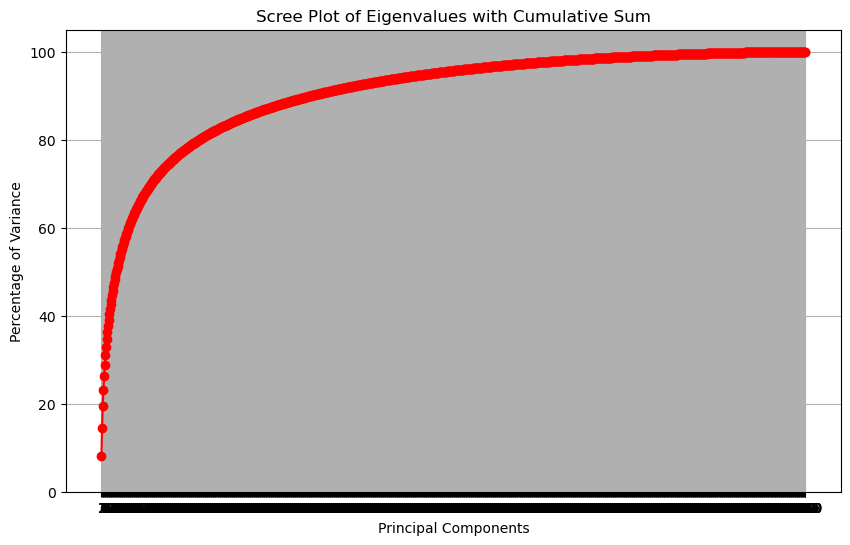

,Principal Components,Explained variance,% Explained Variance,% cum. Exp. Variance
740,PC741,0.627572,0.0,99.0
741,PC742,0.624327,0.0,99.0
742,PC743,0.620798,0.0,99.0
743,PC744,0.619381,0.0,99.0
744,PC745,0.616896,0.0,99.0


In [37]:
exp_var_df = pd.DataFrame({
        "Principal Components" : ["PC" + str(x + 1) for x in range(pca.n_components_)], 
        "Explained variance" : pca.explained_variance_,
        "% Explained Variance" : np.round(pca.explained_variance_ratio_ * 100),
        "% cum. Exp. Variance" : np.round(np.cumsum(pca.explained_variance_ratio_) * 100)})

# calculate explained variance and cumulative

explained_variance = pca.explained_variance_ratio_ * 100
cumulative_variance = explained_variance.cumsum()

# show scree plot

plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center')
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', color='r')
plt.title('Scree Plot of Eigenvalues with Cumulative Sum')
plt.xlabel('Principal Components')
plt.ylabel("Percentage of Variance")
plt.xticks(range(1, len(explained_variance) + 1))
plt.grid(True)
plt.show()
pertinent_df = exp_var_df[exp_var_df['% cum. Exp. Variance'] == 99]
display(pertinent_df.head())

**Commentaires :**  
Avec 741 Composantes Principales, on retrouve 99% de la variance.

---
### 4.4.2 - Application de l'ACP :

In [38]:
# execute PCA on the descriptors matrix

n_components = 741

pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(features)

In [39]:
# create dataframe with columns name

pc_df_cnn = pd.DataFrame(principal_components, 
                     columns=["PC" + str(x + 1) for x in range(n_components)]
                    )

In [40]:
pc_df_cnn.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC732,PC733,PC734,PC735,PC736,PC737,PC738,PC739,PC740,PC741
0,-5.664982,-21.220737,2.122744,2.527427,37.435329,10.680291,-20.252405,-5.890939,2.406503,2.128492,...,0.801387,-0.130201,-0.055753,-0.416120,-0.437991,-0.140865,0.520794,-0.432686,0.984844,-0.725282
1,3.485260,-37.711773,-30.495947,-2.874657,2.025314,43.308258,39.231655,37.163555,-33.433846,35.611919,...,0.495637,1.363361,0.438020,0.401847,-0.281174,-0.597623,-0.427797,-0.706202,-0.101100,0.974332
2,-4.120130,-33.633457,-10.051226,-10.470085,-12.944553,13.593489,3.516179,3.649623,-0.691883,6.297503,...,0.487568,-0.379910,0.004690,1.474996,0.032378,0.482575,-1.691245,-0.238442,0.991297,0.175327
3,-11.230229,-24.357248,-7.979755,-0.338820,21.142733,26.129242,9.957994,13.305173,1.099180,11.048435,...,1.181761,0.181927,-1.340094,0.031343,0.080109,-2.489923,-0.511795,-0.732224,-0.839895,0.811897
4,-17.411087,-31.597488,3.737263,-1.380587,36.090290,23.510395,-11.203244,11.268752,10.511471,-8.045093,...,0.356747,0.327792,-0.431220,0.261840,0.978522,-0.881464,-0.162775,-0.755286,0.735412,0.829316


### 4.4.3 - Réduction de dimension t-SNE :

In [41]:
X_tsne_cnn = TSNE(n_components=2, 
                        learning_rate='auto', 
                        init='random', 
                        perplexity=30,
                        random_state=42
                       ).fit_transform(features)

df_tsne_cnn = pd.DataFrame(data=X_tsne_cnn, columns=["TSNE_1", "TSNE_2"])
df_tsne_cnn['category'] = df['category']

In [42]:
df_tsne_cnn.shape

(1050, 3)

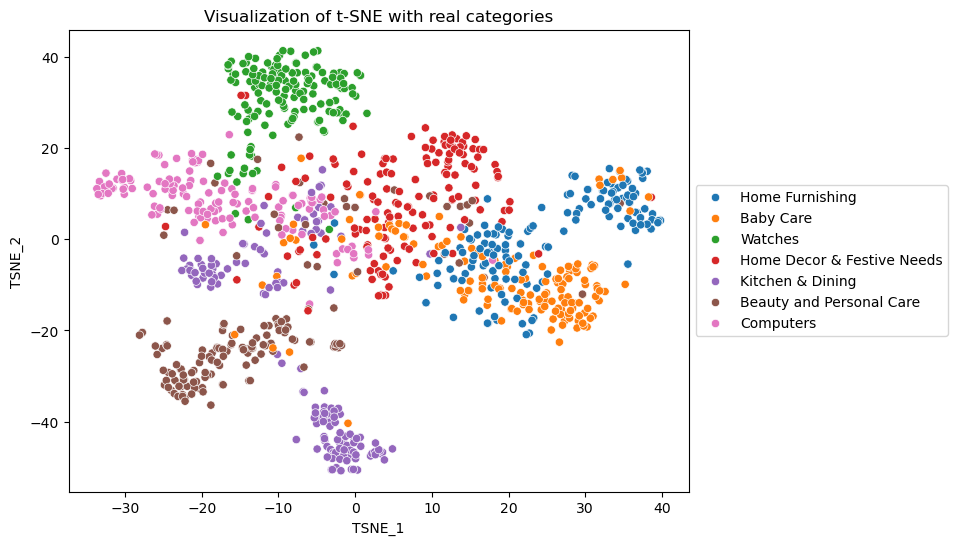

In [43]:
plt.figure(figsize=(8, 6))
sns.scatterplot(
        x="TSNE_1", 
        y="TSNE_2", 
        hue="category", 
        data=df_tsne_cnn, 
        palette=sns.color_palette('tab10', n_colors=7)
    )
plt.title(f"Visualization of t-SNE with real categories")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

**Commentaires :**  
On repère des groupements de catégories, mais des mélanges au centre du graphique.

### 4.4.4 - Classification KMeans :

In [44]:
# fit kmeans and time

kmeans_cnn = KMeans(n_clusters=7, init="k-means++", n_init=1, random_state=42)

start_time = time.time()
kmeans_cnn.fit(X_tsne_cnn)
end_time = time.time()
print("Clustering took {:.2f} s".format(end_time - start_time))

Clustering took 0.01 s


In [45]:
# retrieve labels

df_tsne_cnn['cluster'] = kmeans_cnn.labels_

### 4.4.5 - Visualisation et score ARI :

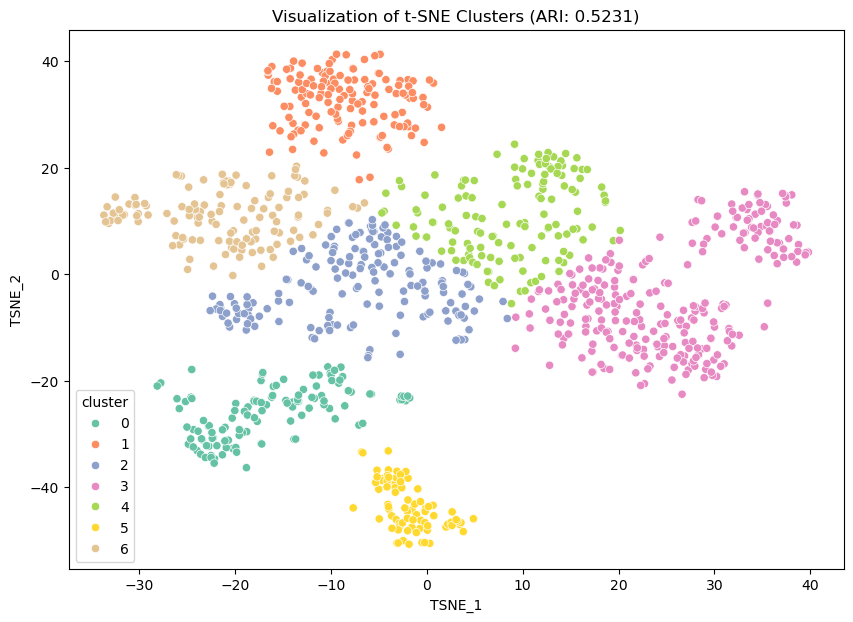

ARI score : 0.5230562543142211


In [46]:
# functions to reduce by t-SNE and calculate ARI score

visualize_tsne(df_tsne_cnn, true_labels_encoded)

### 4.4.6 - Matrice de confusion :

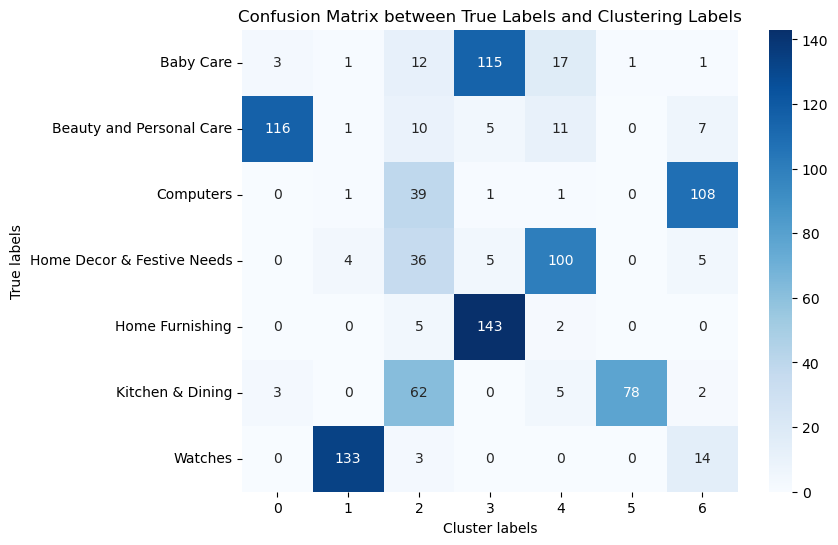

In [49]:
# confusion matrix
cm = confusion_matrix(df['category_encoded'], kmeans_cnn.labels_)

# heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=range(0, 7), yticklabels=encoder.classes_)
plt.xlabel('Cluster labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix between True Labels and Clustering Labels')
plt.show()

**Commentaires :**  
Sur cette matrice, on trouve :
* une catégorie plutôt bien prédite ==> "watches" = **cluster 1**
* des catégories perfectibles ==> "Home decor" == **cluster 4** , "Computers" == **cluster 6** et "Beauty and Personal Care" == **cluster 0**  
* une catégorie entre 2 clusters : "kitchen & dining" =? **cluster 5**  
* deux catégories sur le même cluster ==> "Baby Care" et "Home Furnishing" qui ont un MAX sur **cluster 3**
* **cluster 2** avec beaucoup d'erreurs et pas de catégorie claire


## 4.5 - Conclusion de la faisabilité :

| Methods                | ARI score |
|------------------------|-----------|
| BoVW / KMeans k = 717  | 0.082     |
| BoVW / KMeans k = 70   | 0.060     |
| VGG-16 pretrained      | 0.52      |


La méthode des Réseaux de Neurones Convolutifs est clairement meilleure que les méthodes plus basiques même s'il serait encore possible de l'améliorer avec par exemple un entrainement de certaines couches du CNN avec notre dataset.